In [ ]:
!pip install diffusers transformers accelerate

from diffusers import StableDiffusionPipeline, StableDiffusionImg2ImgPipeline
from PIL import Image
import torch
import os


device = "cuda" if torch.cuda.is_available() else "cpu"
dtype = torch.float16 if device == "cuda" else torch.float32


txt2img_pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=dtype
).to(device)

img2img_pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=dtype
).to(device)


def load_image(path):
    img = Image.open(path).convert("RGB")
    if img.size != (512, 512):
        img = img.resize((512, 512))
    return img


def baseline_identity_only(image_path, save_path):
    img = load_image(image_path)
    img.save(save_path)
    print(f"✅ Saved original image → {save_path}")


def baseline_prompt_only(target_age, gender, save_path):
    prompt = f"a {target_age} year old {gender} person"
    neg_prompt = "blurry, low quality, distorted, extra face parts"

    img = txt2img_pipe(
        prompt=prompt,
        negative_prompt=neg_prompt,
        guidance_scale=7.5,
        num_inference_steps=25
    ).images[0]
    img.save(save_path)
    print(f"✅ Saved prompt-only image → {save_path}")


def baseline_img2img_edit(image_path, target_age, gender, save_path):
    prompt = f"a {target_age} year old {gender} person"
    neg_prompt = "blurry, low quality, distorted, extra eyes"

    init_img = load_image(image_path)

    img = img2img_pipe(
        prompt=prompt,
        image=init_img,
        strength=0.7,
        guidance_scale=7.5,
        negative_prompt=neg_prompt,
        num_inference_steps=25
    ).images[0]
    img.save(save_path)
    print(f"✅ Saved img2img aging → {save_path}")


Defaulting to user installation because normal site-packages is not writeable


/home/koppisetty.e/.local/lib/python3.8/site-packages/torch/cuda/__init__.py:138: UserWarning: CUDA initialization: The NVIDIA driver on your system is too old (found version 11040). Please update your GPU driver by downloading and installing a new version from the URL: http://www.nvidia.com/Download/index.aspx Alternatively, go to: https://pytorch.org to install a PyTorch version that has been compiled with your version of the CUDA driver. (Triggered internally at ../c10/cuda/CUDAFunctions.cpp:108.)
  return torch._C._cuda_getDeviceCount() > 0
/home/koppisetty.e/.local/lib/python3.8/site-packages/bitsandbytes/cextension.py:34: UserWarning: The installed version of bitsandbytes was compiled without GPU support. 8-bit optimizers, 8-bit multiplication, and GPU quantization are unavailable.
  warn("The installed version of bitsandbytes was compiled without GPU support. "


/home/koppisetty.e/.local/lib/python3.8/site-packages/bitsandbytes/libbitsandbytes_cpu.so: undefined symbol: cadam32bit_grad_fp32


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:


img_name = "13_0_2_20170103201143159.jpg"
input_path = f"/{img_name}"
target_age = 45
gender = "male"


os.makedirs("outputs/baselines/identityOnly", exist_ok=True)
os.makedirs("outputs/baselines/promptOnly", exist_ok=True)
os.makedirs("outputs/baselines/imageToImage", exist_ok=True)


baseline_identity_only(input_path, f"outputs/baselines/identityOnly/{img_name}_original.jpg")
baseline_prompt_only(target_age, gender, f"outputs/baselines/promptOnly/{img_name}_prompt_only.jpg")
baseline_img2img_edit(input_path, target_age, gender, f"outputs/baselines/imageToImage/{img_name}_img2img.jpg")


✅ Saved original image → outputs/baselines/identityOnly/13_0_2_20170103201143159.jpg_original.jpg


  0%|          | 0/25 [00:00<?, ?it/s]

✅ Saved prompt-only image → outputs/baselines/promptOnly/13_0_2_20170103201143159.jpg_prompt_only.jpg


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/imageToImage/13_0_2_20170103201143159.jpg_img2img.jpg


🖼️ Original


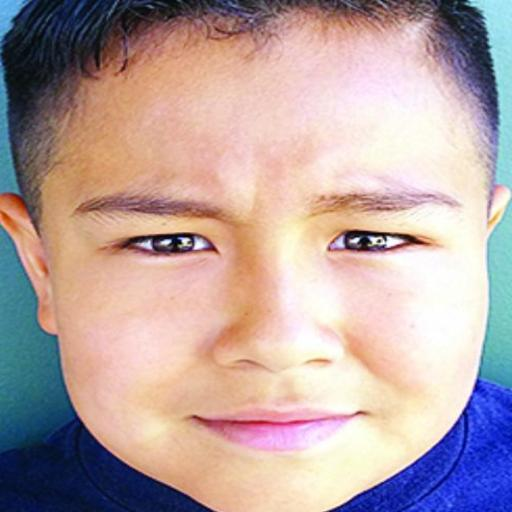

🖼️ Img2Img


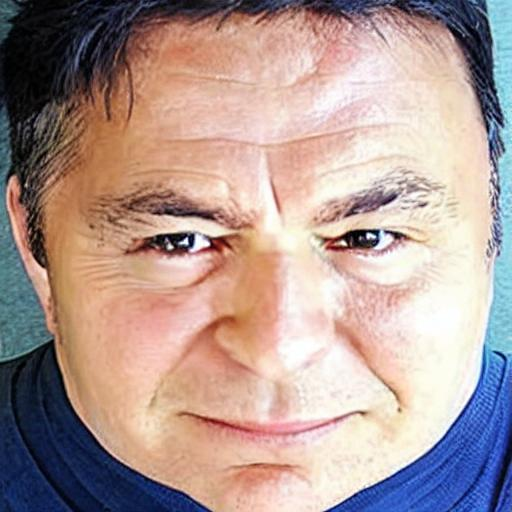

In [ ]:
import os

from IPython.display import display
from PIL import Image

img_name = "13_0_2_20170103201143159.jpg"


base_path = "outputs/baselines"
paths = {
    "Original": f"{base_path}/identityOnly/{img_name}_original.jpg",
    #"PromptOnly": f"{base_path}/promptOnly/{img_name}_prompt_only.jpg",
    "Img2Img": f"{base_path}/imageToImage/{img_name}_img2img.jpg"
}


for label, path in paths.items():
    print(f"🖼️ {label}")
    try:
        img = Image.open(path)
        display(img)
    except FileNotFoundError:
        print(f"❌ File not found: {path}")



In [ ]:
!pip install --quiet diffusers transformers accelerate


from diffusers import StableDiffusionImg2ImgPipeline
import torch
from PIL import Image
import os


device = "cuda" if torch.cuda.is_available() else "cpu"
dtype = torch.float16 if device == "cuda" else torch.float32


pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=dtype,
    safety_checker=None
).to(device)


def load_image(path):
    image = Image.open(path).convert("RGB")
    if image.size != (512, 512):
        image = image.resize((512, 512))
    return image


def simulate_aging(image_path, target_age, gender, output_path=None):
    prompt = f"a {target_age} year old {gender} person"
    negative_prompt = "blurry, low quality, distorted, extra eyes, extra teeth, glasses"

    input_image = load_image(image_path)

    result = pipe(
        prompt=prompt,
        image=input_image,
        strength=0.7,
        guidance_scale=7.5,
        negative_prompt=negative_prompt,
        num_inference_steps=15  
    ).images[0]

    if output_path:
        os.makedirs(os.path.dirname(output_path), exist_ok=True)
        result.save(output_path)
        print(f"✅ Saved aged image to {output_path}")
    return result


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_img2img.StableDiffusionImg2ImgPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to aged_outputs/40_to_70.jpg


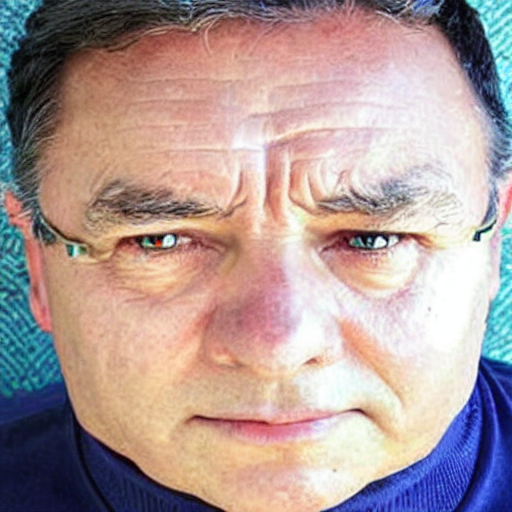

In [ ]:
img_name = "13_0_2_20170103201143159.jpg"
img_path = f"/{img_name}"
simulate_aging(
    image_path="/13_0_2_20170103201143159.jpg",
    target_age=45,
    gender="male",
    output_path="aged_outputs/40_to_70.jpg"
)
#observation seems like the model associates glasses with older people!!

In [ ]:
import pandas as pd
import os
import random
from PIL import Image
from IPython.display import display, HTML



def process_batch(start, end, input_csv="utk_train_balanced.csv", output_csv="outputs_part.csv"):
    df = pd.read_csv(input_csv)
    batch_df = df.iloc[start:end]
    rows = []

    for idx, row in batch_df.iterrows():
        original_name = row["filename"]
        gender = row["gender"]
        old_age = int(row["age"])

        
        min_new_age = old_age + 10
        if min_new_age > 100:
            print(f"⏩ Skipping {original_name} (too old)")
            continue
        new_age = random.randint(min_new_age, 100)

        
        original_path = f"subset150/{original_name}"
        baseline3_name = f"{original_name}_aged_{new_age}.jpg"
        finetuned_name = f"{original_name}_aged_{new_age}.jpg"
        baseline3_path = os.path.join("outputs/baselines", baseline3_name)
        finetuned_path = os.path.join("outputs/finetuned", finetuned_name)

        
        if not os.path.exists(baseline3_path):
            baseline_img2img_edit(original_path, new_age, gender, baseline3_path)
        else:
            print(f"✅ Baseline3 already exists: {baseline3_path}")

        
        if not os.path.exists(finetuned_path):
            simulate_aging(original_path, new_age, gender, finetuned_path)
        else:
            print(f"✅ Finetuned already exists: {finetuned_path}")

        
        print(f"\n🧾 [{idx+1}] {original_name} → aged to {new_age} ({gender})")
        display_images = []
        for label, path in [
            ("Original", original_path),
            ("Baseline3", baseline3_path),
            ("Finetuned", finetuned_path)
        ]:
            try:
                img = Image.open(path).resize((256, 256))
                display_images.append(f'<div style="text-align:center"><img src="{path}" width="256"><br>{label}</div>')
            except Exception as e:
                display_images.append(f'<div style="text-align:center"><b>❌ Missing</b><br>{label}</div>')

        display(HTML(f'<div style="display:flex; gap:15px;">{"".join(display_images)}</div>'))

        
        rows.append({
            "original_image_name": original_name,
            "baseline3_image_name": baseline3_name,
            "original_image_path": original_path,
            "baseline3_image_path": baseline3_path,
            "finetuned_image_path": finetuned_path,
            "gender": gender,
            "old_age": old_age,
            "new_age": new_age
        })

    out_df = pd.DataFrame(rows)
    out_df.to_csv(output_csv, index=False)
    print(f"\n✅ Saved {len(rows)} entries to {output_csv}")


In [18]:
process_batch(start=0, end=10, output_csv="outputs_part1.csv")





  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/9_0_2_20170110215518068.jpg_aged_50.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/9_0_2_20170110215518068.jpg_aged_50.jpg

🧾 [1] 9_0_2_20170110215518068.jpg → aged to 50 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/8_1_2_20170109205424712.jpg_aged_21.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/8_1_2_20170109205424712.jpg_aged_21.jpg

🧾 [2] 8_1_2_20170109205424712.jpg → aged to 21 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/12_1_2_20170109203838187.jpg_aged_36.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/12_1_2_20170109203838187.jpg_aged_36.jpg

🧾 [3] 12_1_2_20170109203838187.jpg → aged to 36 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/13_0_2_20170103201143159.jpg_aged_28.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/13_0_2_20170103201143159.jpg_aged_28.jpg

🧾 [4] 13_0_2_20170103201143159.jpg → aged to 28 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/24_1_2_20170109213251114.jpg_aged_43.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/24_1_2_20170109213251114.jpg_aged_43.jpg

🧾 [5] 24_1_2_20170109213251114.jpg → aged to 43 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/66_0_2_20170111205753656.jpg_aged_88.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/66_0_2_20170111205753656.jpg_aged_88.jpg

🧾 [6] 66_0_2_20170111205753656.jpg → aged to 88 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/65_0_2_20170111205651706.jpg_aged_80.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/65_0_2_20170111205651706.jpg_aged_80.jpg

🧾 [7] 65_0_2_20170111205651706.jpg → aged to 80 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/69_1_2_20170111210824053.jpg_aged_86.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/69_1_2_20170111210824053.jpg_aged_86.jpg

🧾 [8] 69_1_2_20170111210824053.jpg → aged to 86 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/76_1_2_20170110182935621.jpg_aged_90.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/76_1_2_20170110182935621.jpg_aged_90.jpg

🧾 [9] 76_1_2_20170110182935621.jpg → aged to 90 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/75_0_2_20170111210029130.jpg_aged_96.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/75_0_2_20170111210029130.jpg_aged_96.jpg

🧾 [10] 75_0_2_20170111210029130.jpg → aged to 96 (man)



✅ Saved 10 entries to outputs_part1.csv


In [ ]:
process_batch(start=10, end=20, output_csv="outputs_part2.csv")



  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/85_1_2_20170110175723033.jpg_aged_96.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/85_1_2_20170110175723033.jpg_aged_96.jpg

🧾 [11] 85_1_2_20170110175723033.jpg → aged to 96 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/82_0_2_20170111210110290.jpg_aged_93.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

In [11]:
import os
print(os.getcwd())
print(os.listdir())

/home/koppisetty.e/deep learning
['.ipynb_checkpoints', 'DL_model.ipynb', 'Untitled.ipynb', 'subset150', 'utk_train_balanced.csv']


In [4]:
process_batch(start=50, end=60, output_csv="outputs_part6.csv")


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/1_1_4_20170109194502921.jpg_aged_29.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/1_1_4_20170109194502921.jpg_aged_29.jpg

🧾 [51] 1_1_4_20170109194502921.jpg → aged to 29 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/8_1_4_20170109201742209.jpg_aged_98.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/8_1_4_20170109201742209.jpg_aged_98.jpg

🧾 [52] 8_1_4_20170109201742209.jpg → aged to 98 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/13_0_4_20170103201708406.jpg_aged_57.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/13_0_4_20170103201708406.jpg_aged_57.jpg

🧾 [53] 13_0_4_20170103201708406.jpg → aged to 57 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/15_1_4_20170103201247846.jpg_aged_52.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/15_1_4_20170103201247846.jpg_aged_52.jpg

🧾 [54] 15_1_4_20170103201247846.jpg → aged to 52 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/12_0_4_20170103201824880.jpg_aged_29.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/12_0_4_20170103201824880.jpg_aged_29.jpg

🧾 [55] 12_0_4_20170103201824880.jpg → aged to 29 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/13_1_4_20170103201542217.jpg_aged_44.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/13_1_4_20170103201542217.jpg_aged_44.jpg

🧾 [56] 13_1_4_20170103201542217.jpg → aged to 44 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


✅ Saved img2img aging → outputs/baselines/18_0_4_20170103201550447.jpg_aged_62.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/18_0_4_20170103201550447.jpg_aged_62.jpg

🧾 [57] 18_0_4_20170103201550447.jpg → aged to 62 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/63_1_4_20170110180156105.jpg_aged_80.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/63_1_4_20170110180156105.jpg_aged_80.jpg

🧾 [58] 63_1_4_20170110180156105.jpg → aged to 80 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/80_1_4_20170110184132973.jpg_aged_95.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/80_1_4_20170110184132973.jpg_aged_95.jpg

🧾 [59] 80_1_4_20170110184132973.jpg → aged to 95 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/8_1_0_20170109202339392.jpg_aged_58.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/8_1_0_20170109202339392.jpg_aged_58.jpg

🧾 [60] 8_1_0_20170109202339392.jpg → aged to 58 (woman)



✅ Saved 10 entries to outputs_part6.csv


In [5]:
process_batch(start=60, end=70, output_csv="outputs_part7.csv")


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/3_1_0_20170109192939414.jpg_aged_94.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/3_1_0_20170109192939414.jpg_aged_94.jpg

🧾 [61] 3_1_0_20170109192939414.jpg → aged to 94 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/8_1_0_20170109204836782.jpg_aged_81.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/8_1_0_20170109204836782.jpg_aged_81.jpg

🧾 [62] 8_1_0_20170109204836782.jpg → aged to 81 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/9_0_0_20170110215523228.jpg_aged_70.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/9_0_0_20170110215523228.jpg_aged_70.jpg

🧾 [63] 9_0_0_20170110215523228.jpg → aged to 70 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


✅ Saved img2img aging → outputs/baselines/4_0_0_20170110205422145.jpg_aged_95.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/4_0_0_20170110205422145.jpg_aged_95.jpg

🧾 [64] 4_0_0_20170110205422145.jpg → aged to 95 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/18_1_0_20170109214700491.jpg_aged_42.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/18_1_0_20170109214700491.jpg_aged_42.jpg

🧾 [65] 18_1_0_20170109214700491.jpg → aged to 42 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/17_0_0_20170110231535087.jpg_aged_92.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/17_0_0_20170110231535087.jpg_aged_92.jpg

🧾 [66] 17_0_0_20170110231535087.jpg → aged to 92 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/18_1_0_20170109214309566.jpg_aged_32.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/18_1_0_20170109214309566.jpg_aged_32.jpg

🧾 [67] 18_1_0_20170109214309566.jpg → aged to 32 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/14_1_0_20170109212926958.jpg_aged_63.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/14_1_0_20170109212926958.jpg_aged_63.jpg

🧾 [68] 14_1_0_20170109212926958.jpg → aged to 63 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/14_1_0_20170109213541777.jpg_aged_49.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/14_1_0_20170109213541777.jpg_aged_49.jpg

🧾 [69] 14_1_0_20170109213541777.jpg → aged to 49 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/20_1_0_20170103201716816.jpg_aged_72.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/20_1_0_20170103201716816.jpg_aged_72.jpg

🧾 [70] 20_1_0_20170103201716816.jpg → aged to 72 (woman)



✅ Saved 10 entries to outputs_part7.csv


In [6]:
process_batch(start=70, end=80, output_csv="outputs_part8.csv")


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/20_1_0_20170109213411083.jpg_aged_45.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/20_1_0_20170109213411083.jpg_aged_45.jpg

🧾 [71] 20_1_0_20170109213411083.jpg → aged to 45 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/23_0_0_20170111181750321.jpg_aged_51.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/23_0_0_20170111181750321.jpg_aged_51.jpg

🧾 [72] 23_0_0_20170111181750321.jpg → aged to 51 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/45_1_0_20170109221130179.jpg_aged_92.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/45_1_0_20170109221130179.jpg_aged_92.jpg

🧾 [73] 45_1_0_20170109221130179.jpg → aged to 92 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/47_1_0_20170109220517890.jpg_aged_64.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/47_1_0_20170109220517890.jpg_aged_64.jpg

🧾 [74] 47_1_0_20170109220517890.jpg → aged to 64 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/40_0_0_20170104204933500.jpg_aged_78.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/40_0_0_20170104204933500.jpg_aged_78.jpg

🧾 [75] 40_0_0_20170104204933500.jpg → aged to 78 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/56_1_0_20170110173815028.jpg_aged_76.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/56_1_0_20170110173815028.jpg_aged_76.jpg

🧾 [76] 56_1_0_20170110173815028.jpg → aged to 76 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/59_1_0_20170110141359968.jpg_aged_76.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/59_1_0_20170110141359968.jpg_aged_76.jpg

🧾 [77] 59_1_0_20170110141359968.jpg → aged to 76 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


✅ Saved img2img aging → outputs/baselines/52_0_0_20170111195709447.jpg_aged_73.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/52_0_0_20170111195709447.jpg_aged_73.jpg

🧾 [78] 52_0_0_20170111195709447.jpg → aged to 73 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/53_1_0_20170110160643204.jpg_aged_89.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/53_1_0_20170110160643204.jpg_aged_89.jpg

🧾 [79] 53_1_0_20170110160643204.jpg → aged to 89 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/56_0_0_20170111194856535.jpg_aged_97.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/56_0_0_20170111194856535.jpg_aged_97.jpg

🧾 [80] 56_0_0_20170111194856535.jpg → aged to 97 (man)



✅ Saved 10 entries to outputs_part8.csv


In [8]:
process_batch(start=80, end=90, output_csv="outputs_part9.csv")


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/65_0_0_20170111203557764.jpg_aged_76.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/65_0_0_20170111203557764.jpg_aged_76.jpg

🧾 [81] 65_0_0_20170111203557764.jpg → aged to 76 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/65_1_0_20170110132512700.jpg_aged_97.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/65_1_0_20170110132512700.jpg_aged_97.jpg

🧾 [82] 65_1_0_20170110132512700.jpg → aged to 97 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/65_1_0_20170110160643938.jpg_aged_95.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/65_1_0_20170110160643938.jpg_aged_95.jpg

🧾 [83] 65_1_0_20170110160643938.jpg → aged to 95 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/64_1_0_20170110160643892.jpg_aged_80.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/64_1_0_20170110160643892.jpg_aged_80.jpg

🧾 [84] 64_1_0_20170110160643892.jpg → aged to 80 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/61_1_0_20170110160643735.jpg_aged_79.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/61_1_0_20170110160643735.jpg_aged_79.jpg

🧾 [85] 61_1_0_20170110160643735.jpg → aged to 79 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/71_1_0_20170110160644048.jpg_aged_86.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/71_1_0_20170110160644048.jpg_aged_86.jpg

🧾 [86] 71_1_0_20170110160644048.jpg → aged to 86 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/76_0_0_20170111210148707.jpg_aged_99.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/76_0_0_20170111210148707.jpg_aged_99.jpg

🧾 [87] 76_0_0_20170111210148707.jpg → aged to 99 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/77_1_0_20170110160644117.jpg_aged_100.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/77_1_0_20170110160644117.jpg_aged_100.jpg

🧾 [88] 77_1_0_20170110160644117.jpg → aged to 100 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/70_0_0_20170111210749134.jpg_aged_94.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/70_0_0_20170111210749134.jpg_aged_94.jpg

🧾 [89] 70_0_0_20170111210749134.jpg → aged to 94 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/75_1_0_20170110182459565.jpg_aged_97.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/75_1_0_20170110182459565.jpg_aged_97.jpg

🧾 [90] 75_1_0_20170110182459565.jpg → aged to 97 (woman)



✅ Saved 10 entries to outputs_part9.csv


In [ ]:
import pandas as pd


dfs = [pd.read_csv(f"outputs_part{i}.csv") for i in range(1, 16)]


final_df = pd.concat(dfs, ignore_index=True)
final_df.to_csv("outputs.csv", index=False)
print("✅ Merged all 15 parts into outputs.csv")



In [11]:
#display all images
import pandas as pd
from PIL import Image
from matplotlib import pyplot as plt

def show_batch_images(output_csv, max_images=50):
    df = pd.read_csv(output_csv)

    for idx, row in df.head(max_images).iterrows():
        original_path = row["original_image_path"]
        baseline3_path = row["baseline3_image_path"]
        finetuned_path = row["finetuned_image_path"]

        fig, axs = plt.subplots(1, 3, figsize=(15, 5))
        fig.suptitle(f"{row['original_image_name']} → Aged to {row['new_age']} ({row['gender']})", fontsize=14)

        for ax, path, title in zip(
            axs,
            [original_path, baseline3_path, finetuned_path],
            ["Original", "Baseline3 (img2img)", "Finetuned (simulate_aging)"]
        ):
            try:
                img = Image.open(path)
                ax.imshow(img)
                ax.set_title(title)
                ax.axis("off")
            except Exception as e:
                ax.text(0.5, 0.5, "Image not found", ha='center', va='center')
                ax.set_title(title)
                ax.axis("off")

        plt.tight_layout()
        plt.show()


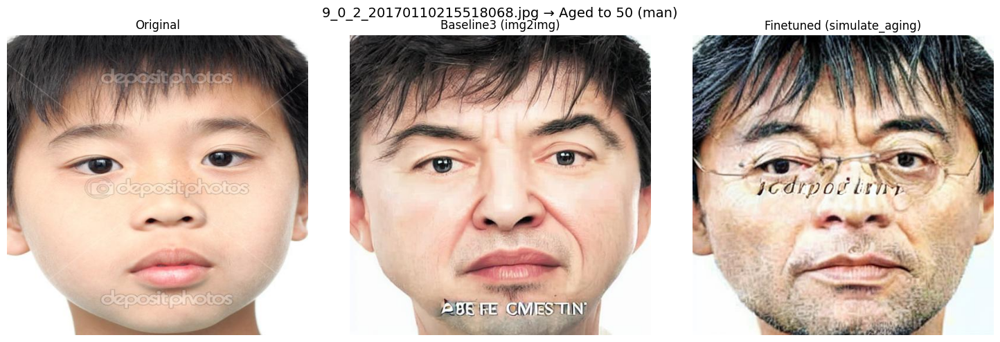

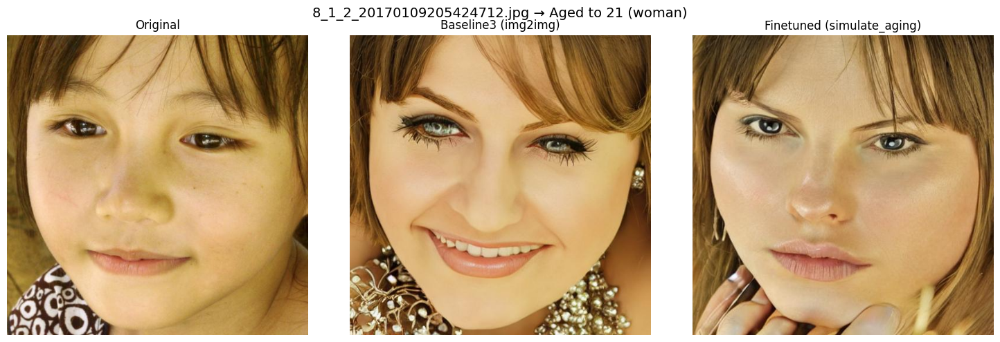

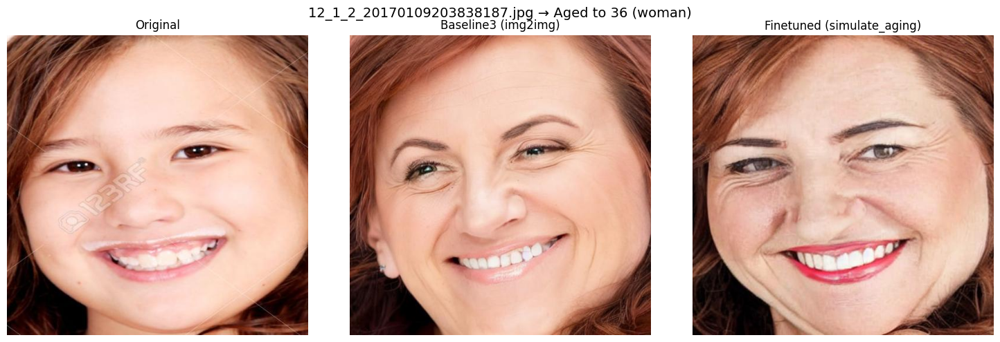

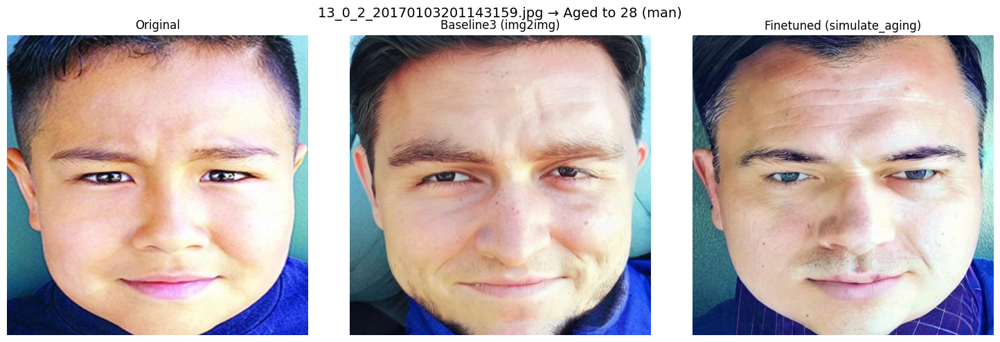

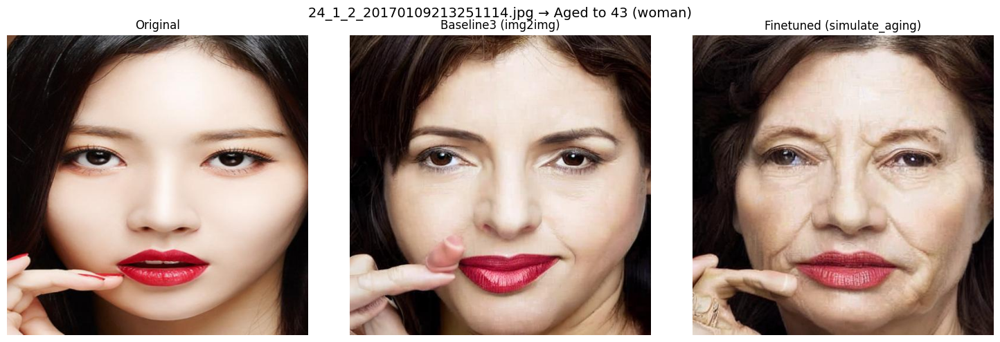

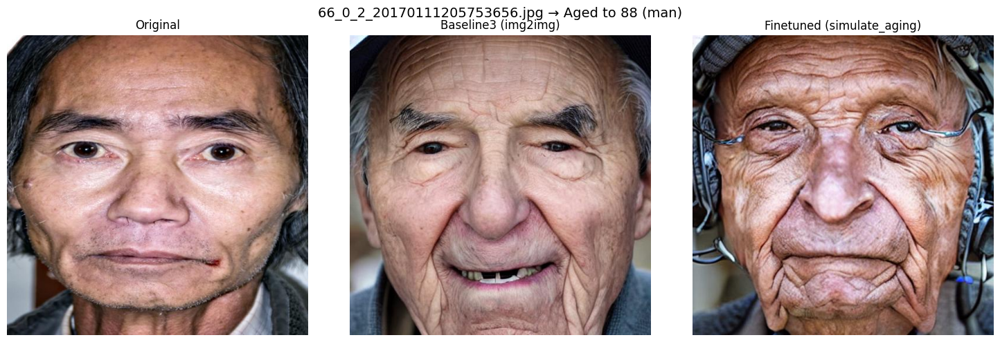

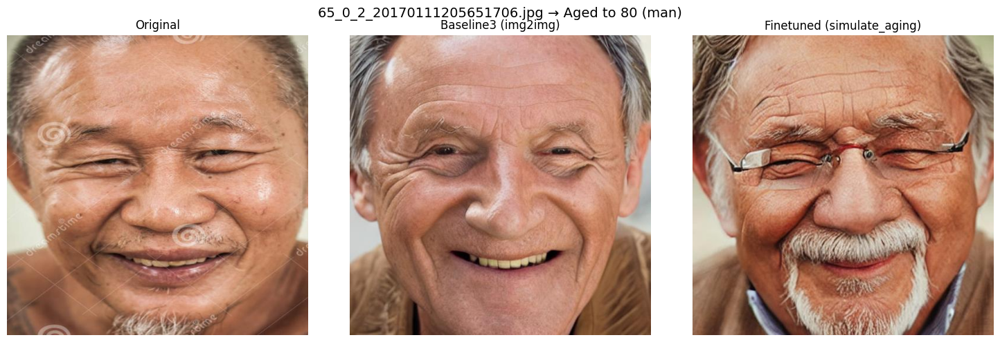

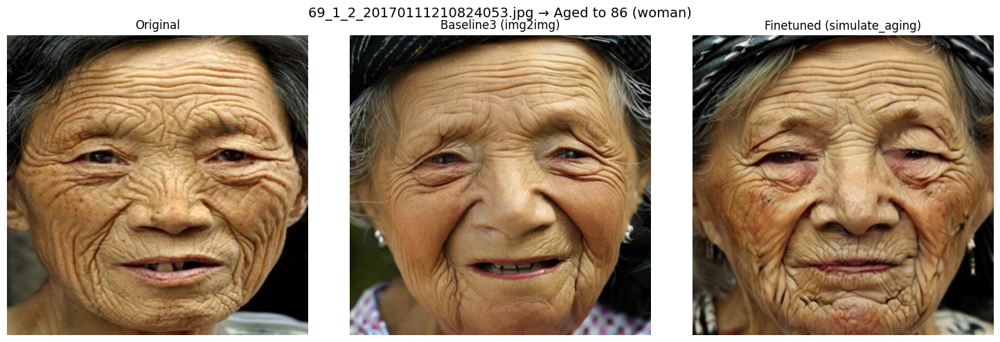

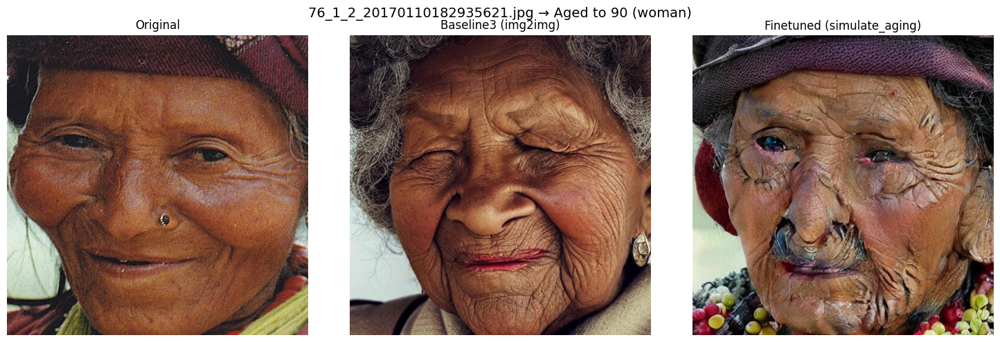

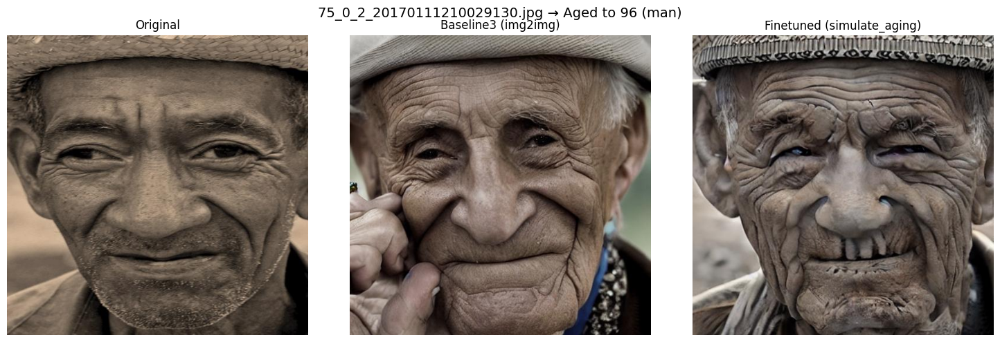

In [20]:
show_batch_images("outputs_part1.csv", max_images=10)


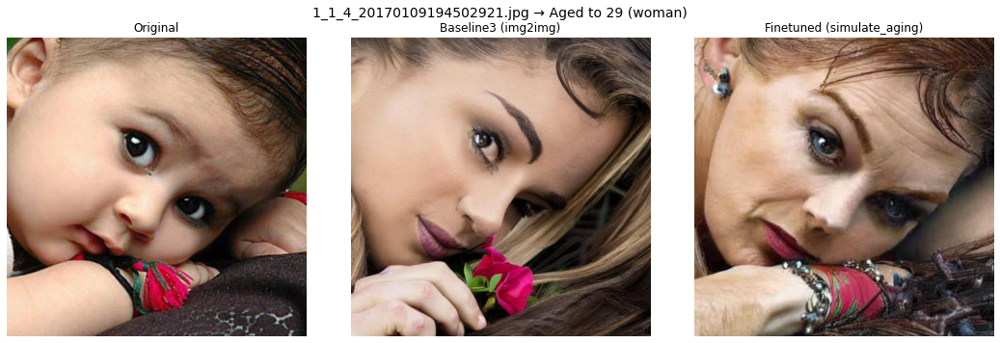

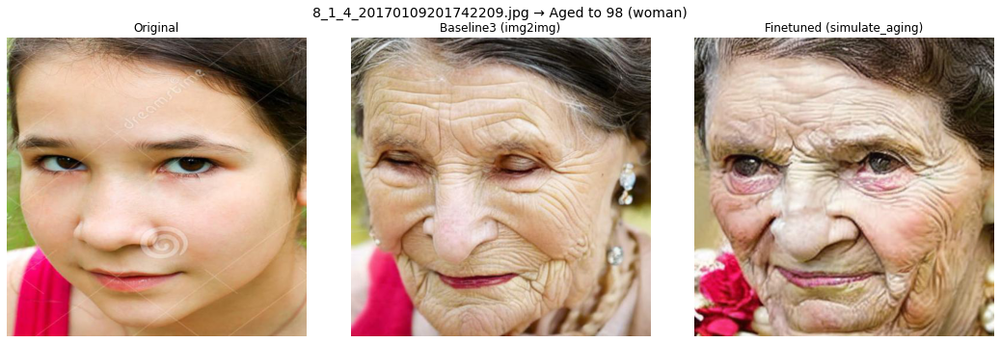

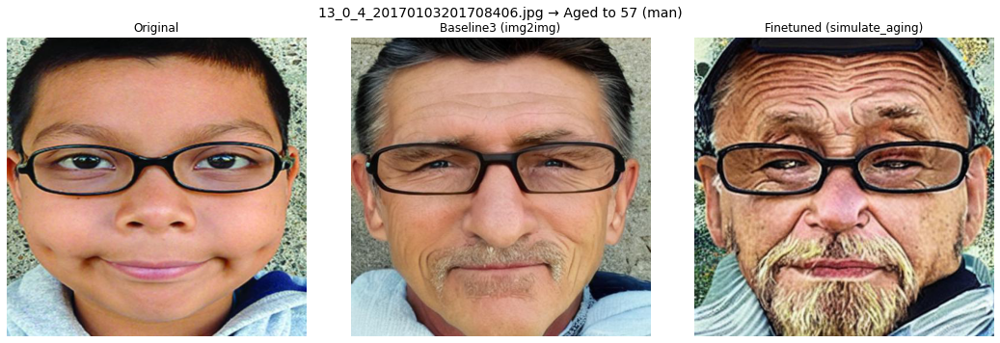

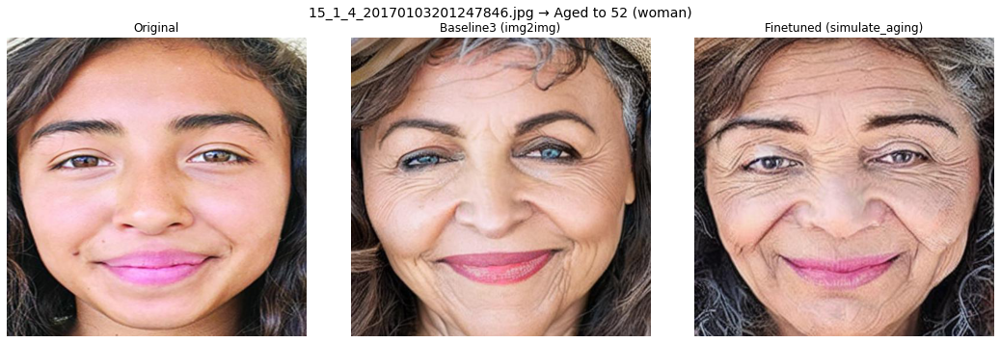

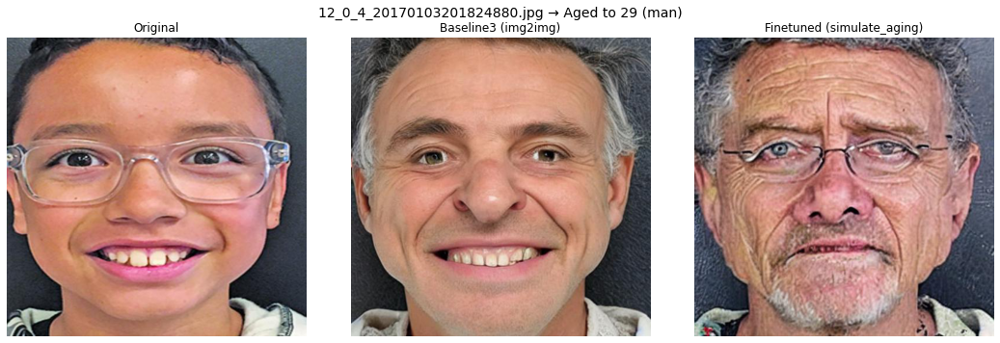

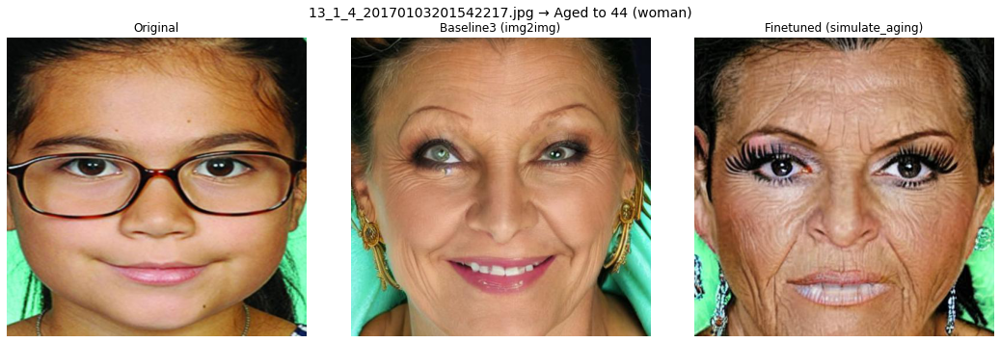

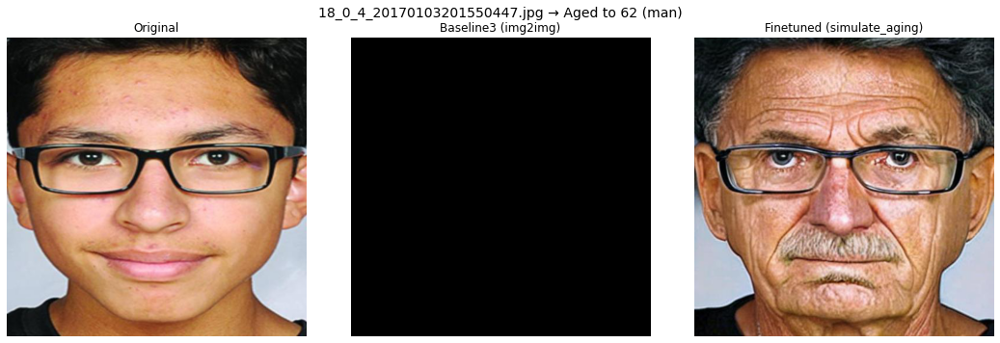

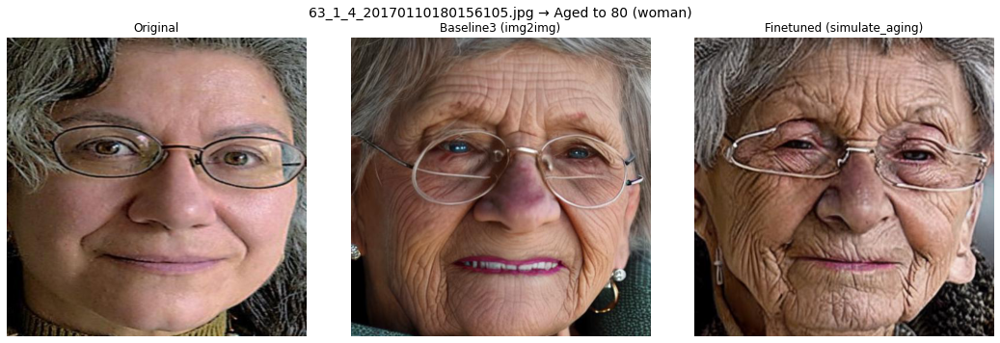

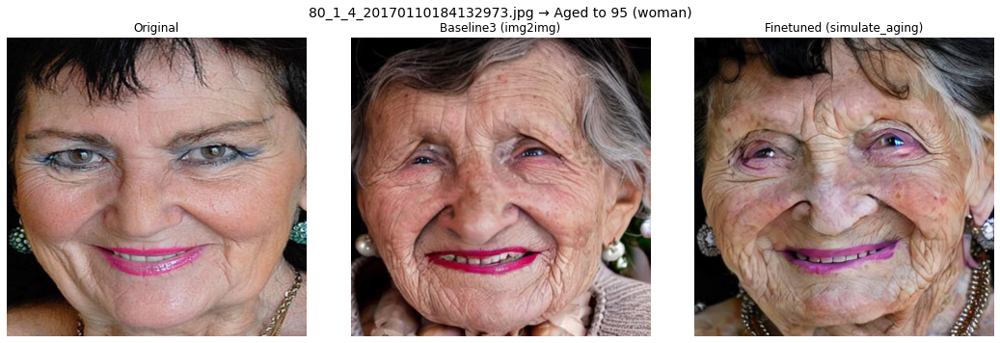

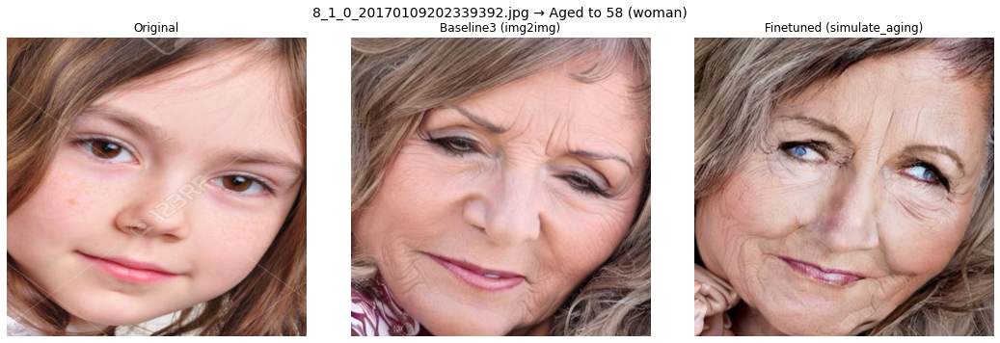

In [12]:
show_batch_images("outputs_part6.csv", max_images=10)

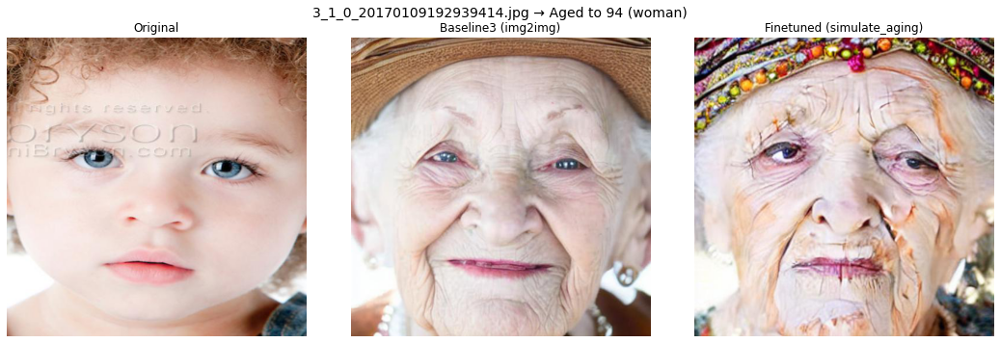

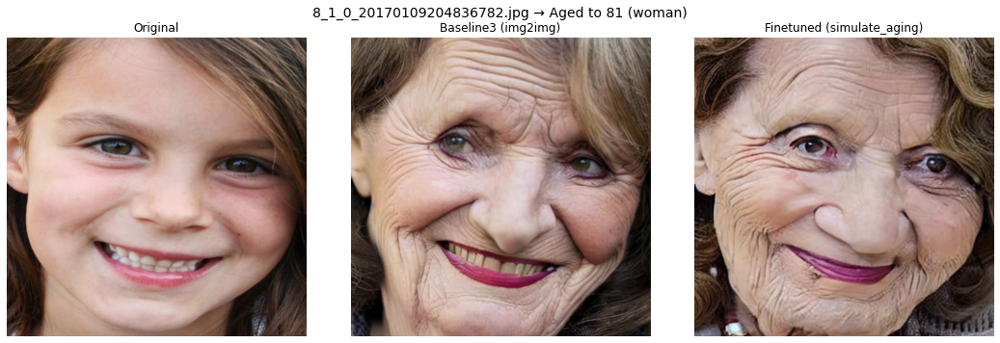

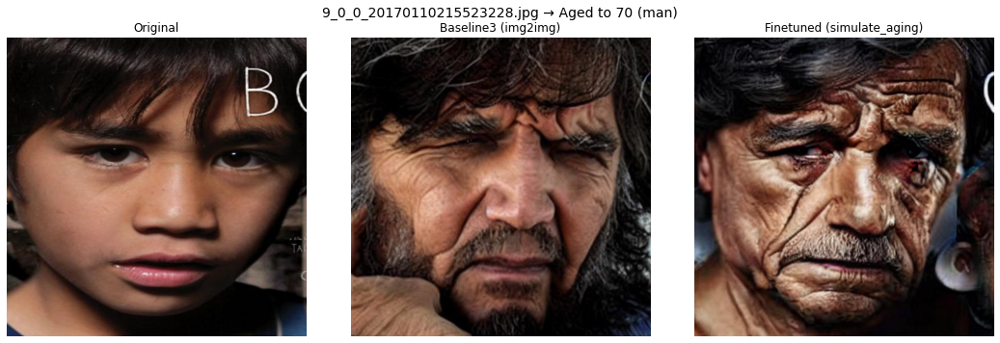

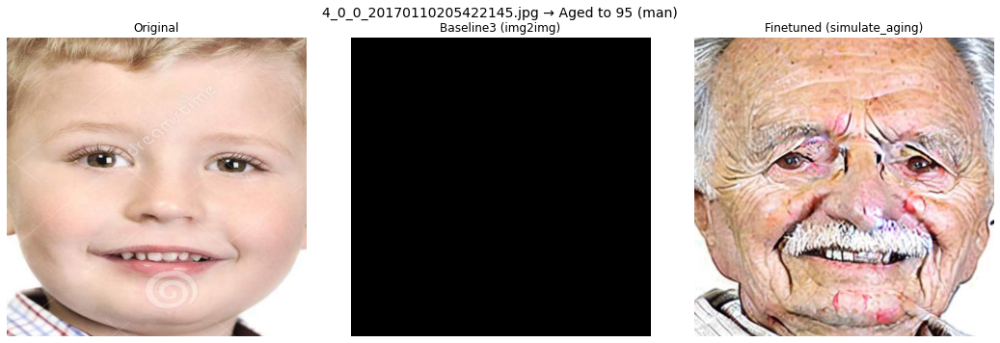

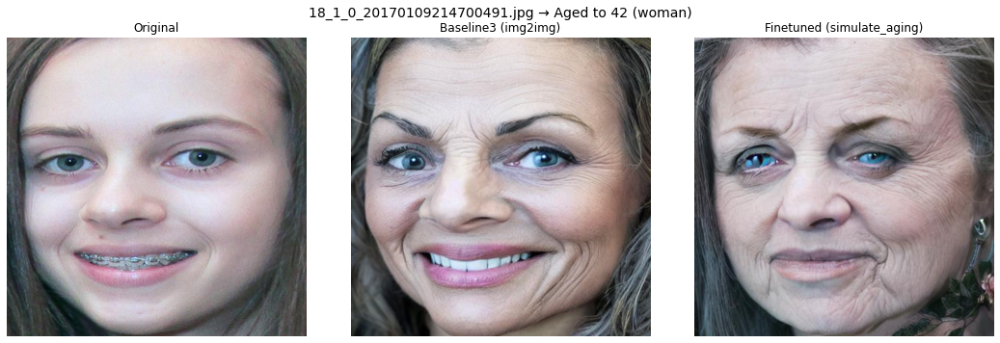

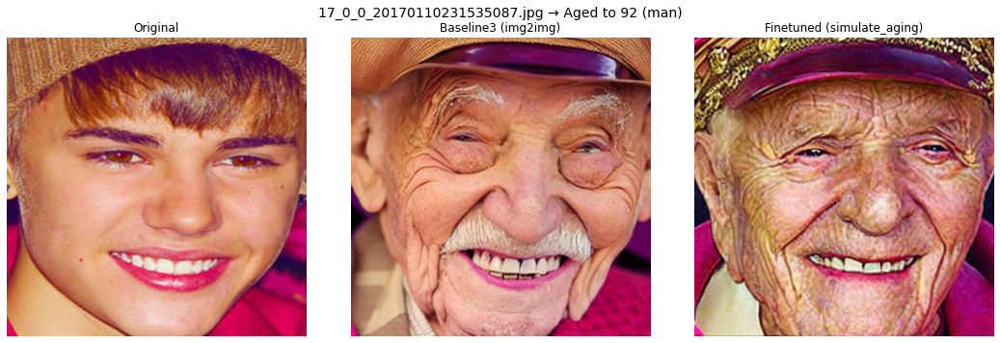

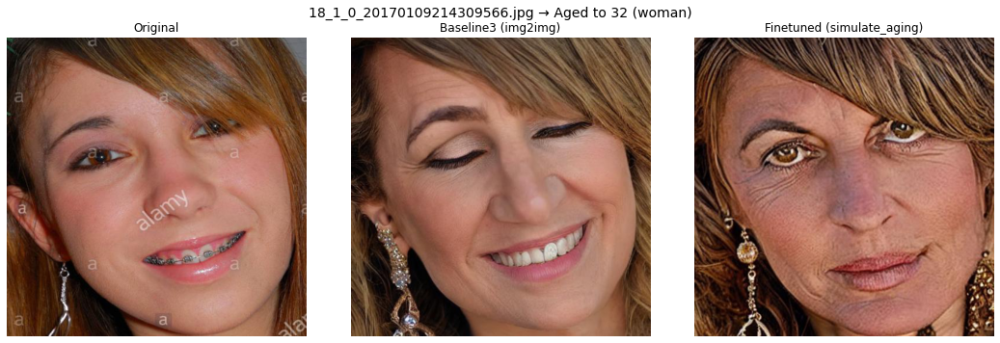

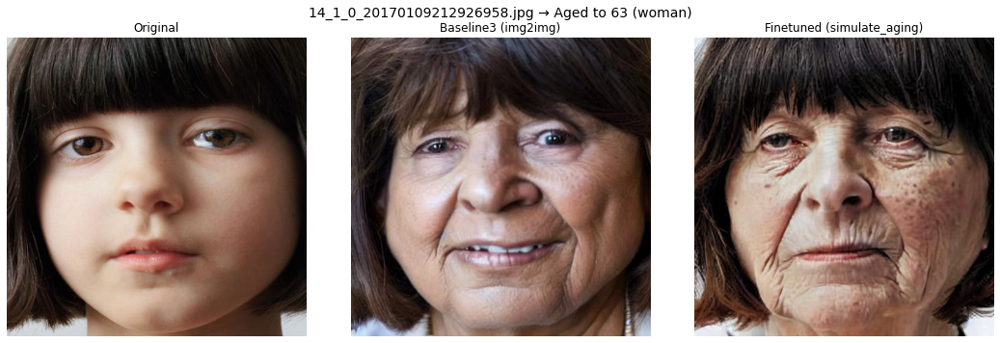

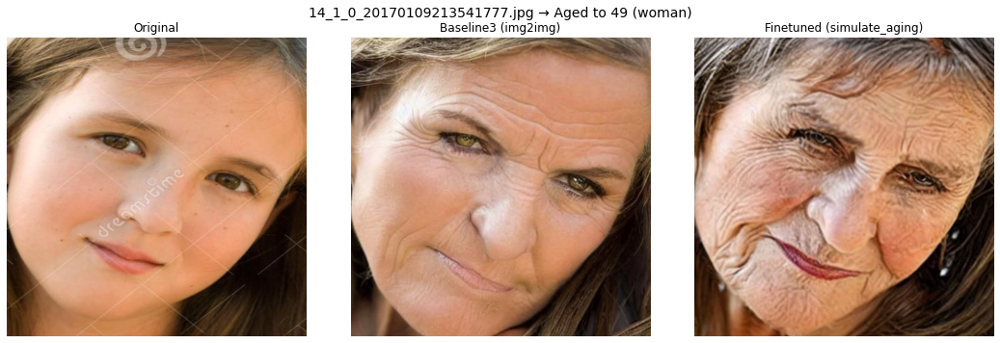

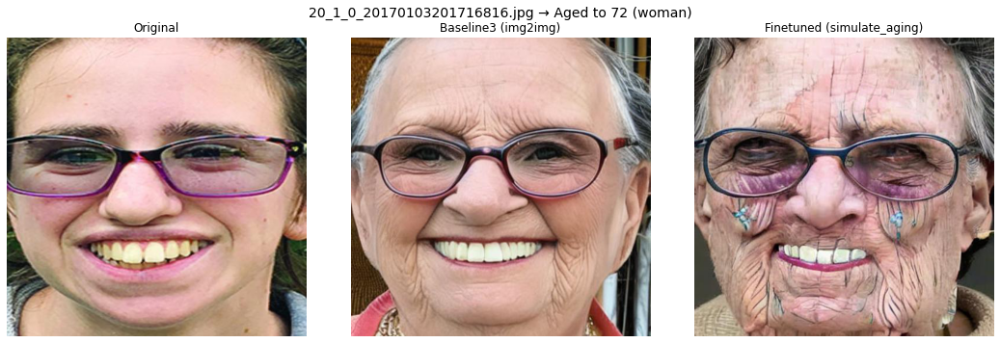

In [13]:
show_batch_images("outputs_part7.csv", max_images=10)

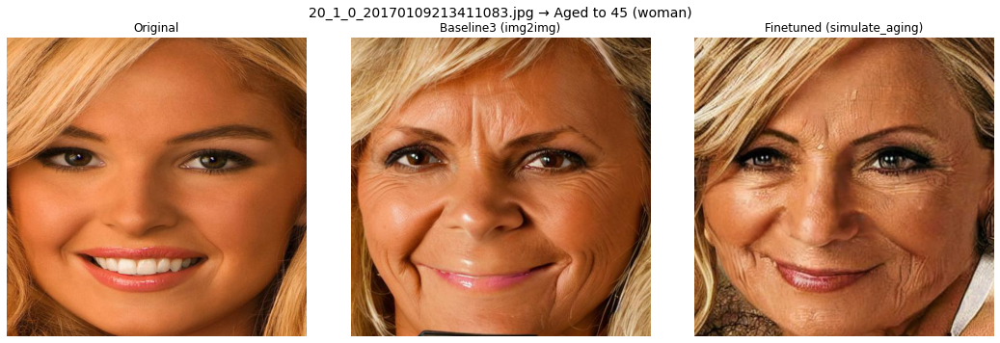

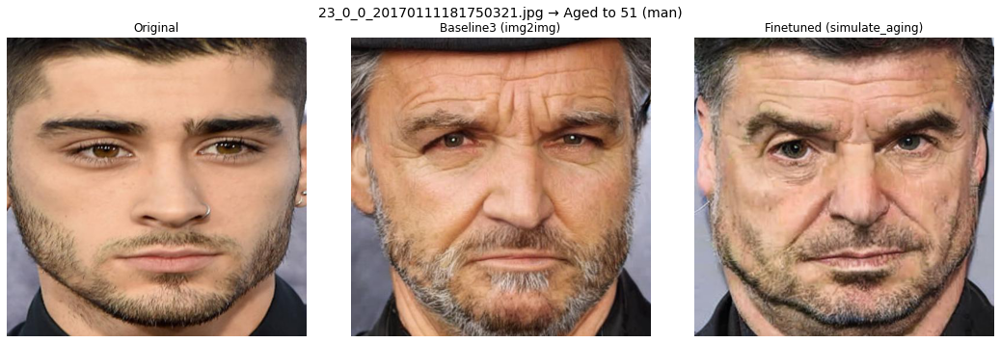

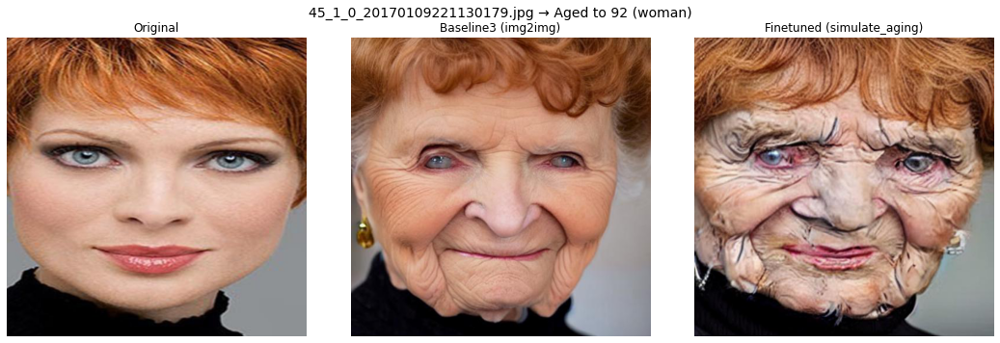

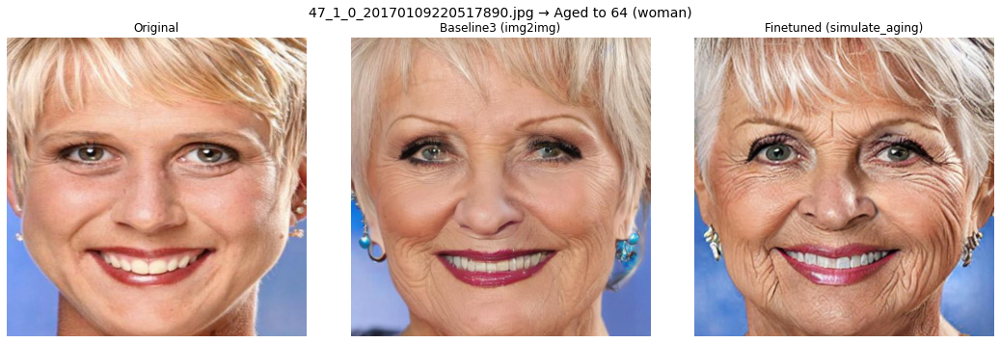

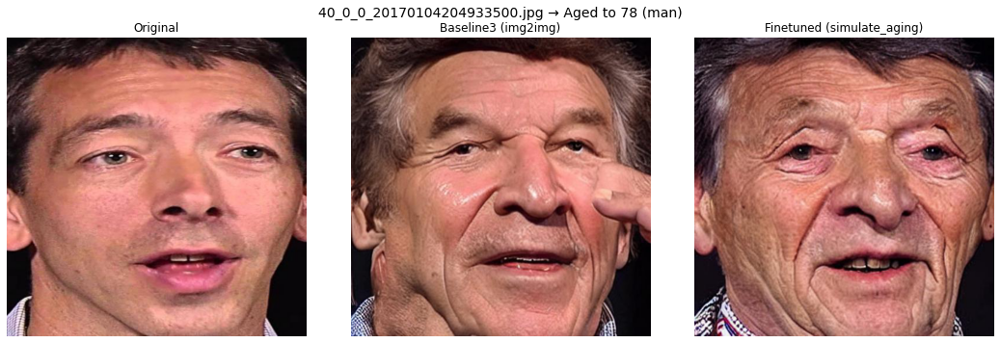

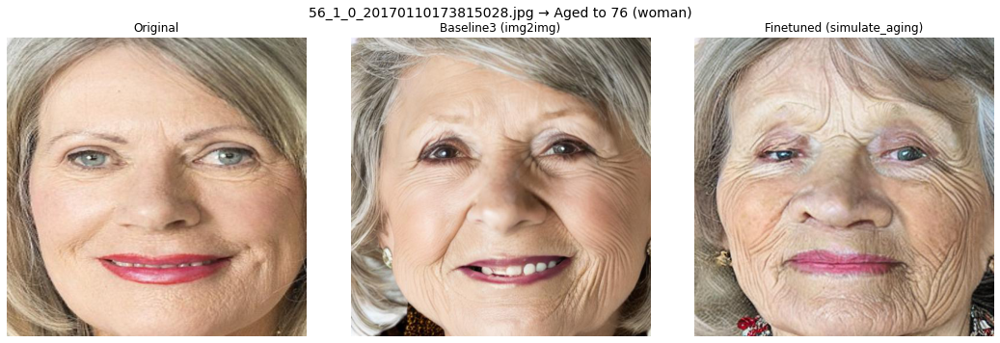

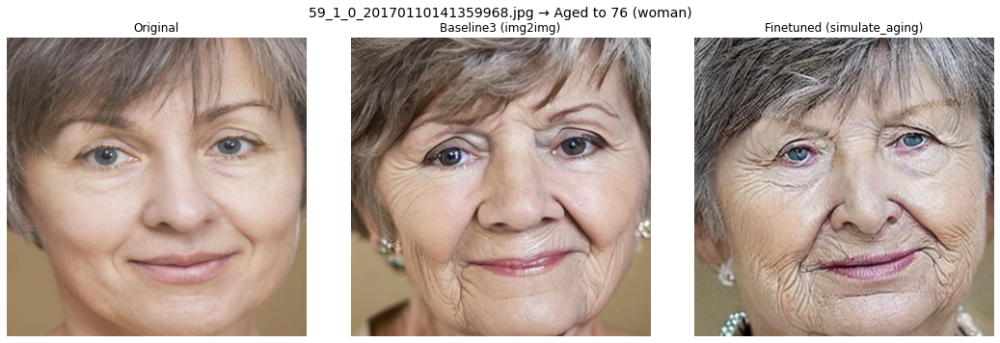

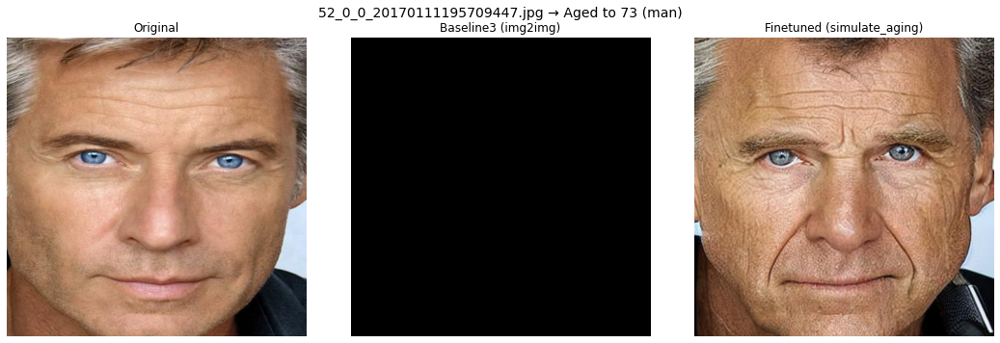

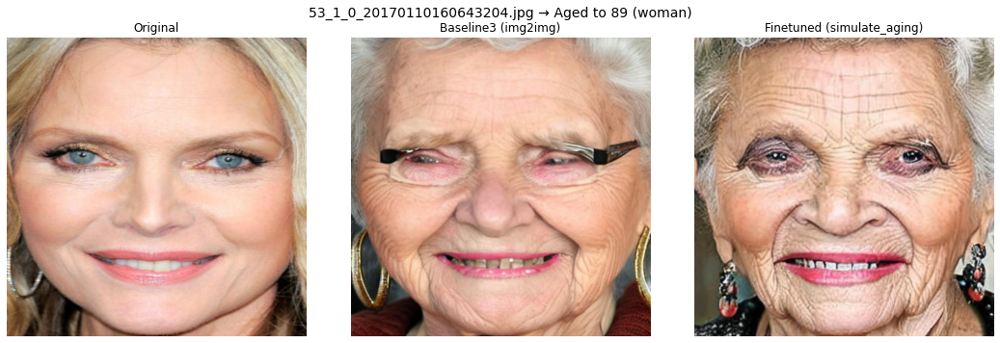

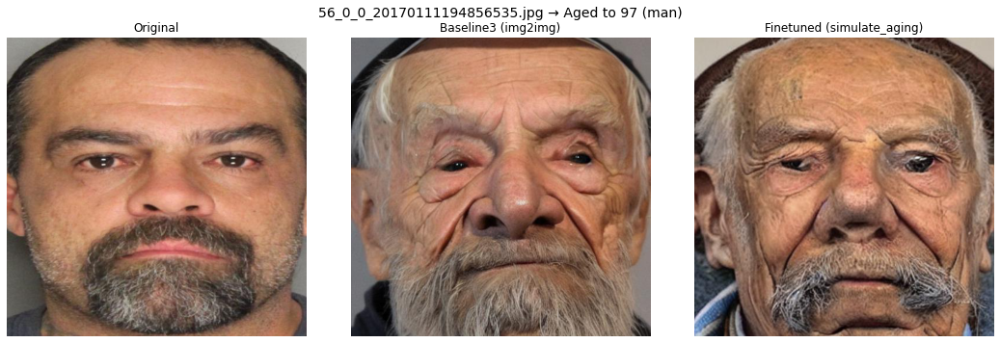

In [14]:
show_batch_images("outputs_part8.csv", max_images=10)

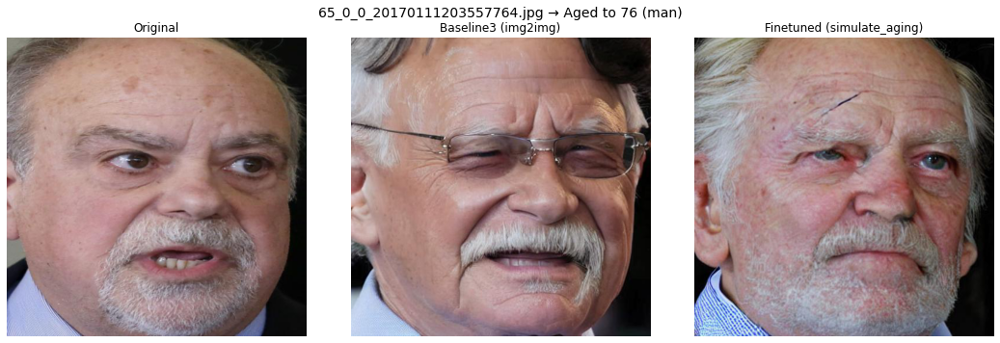

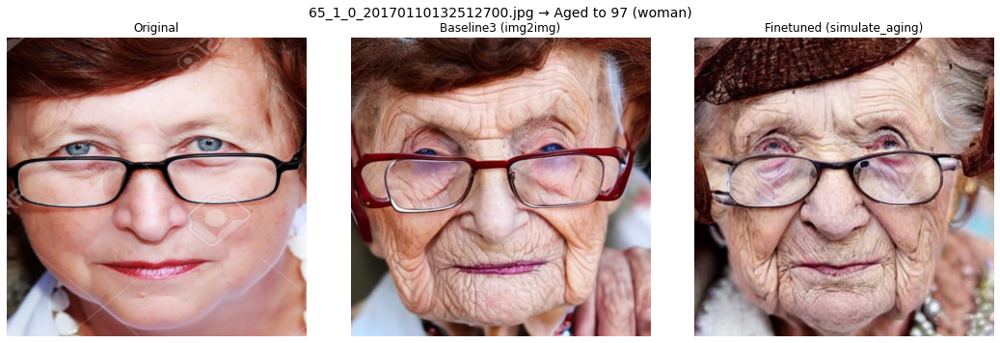

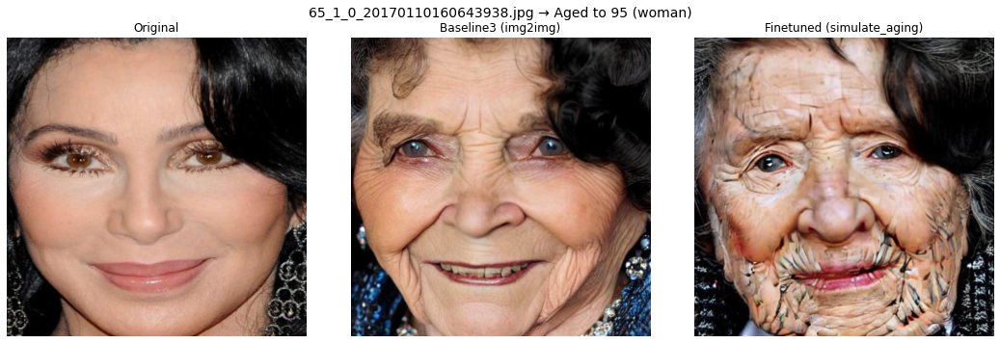

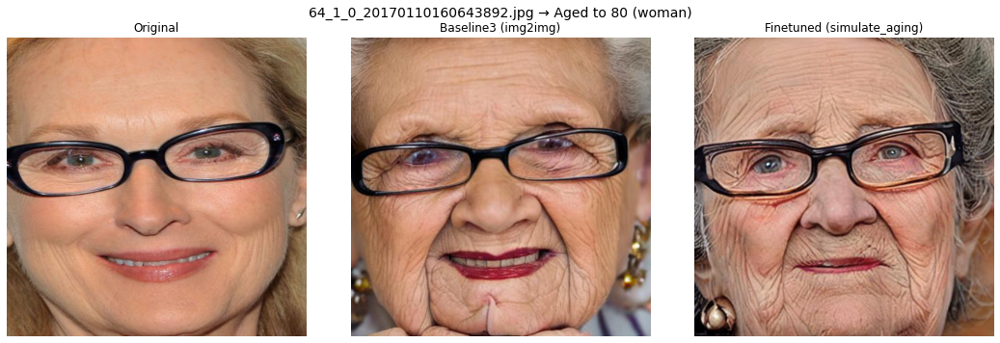

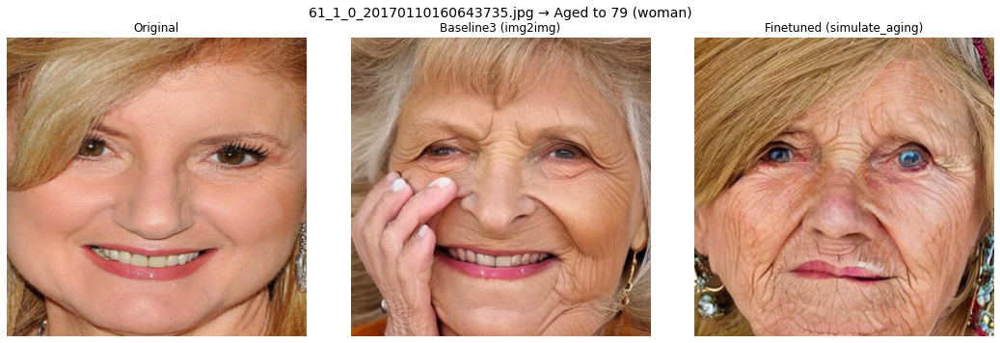

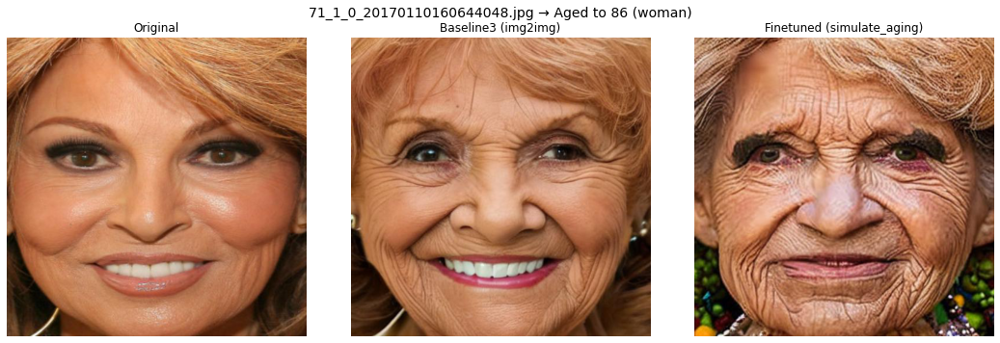

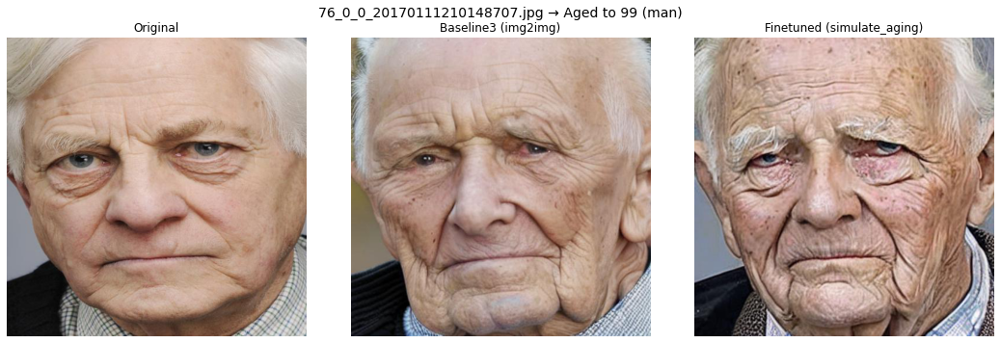

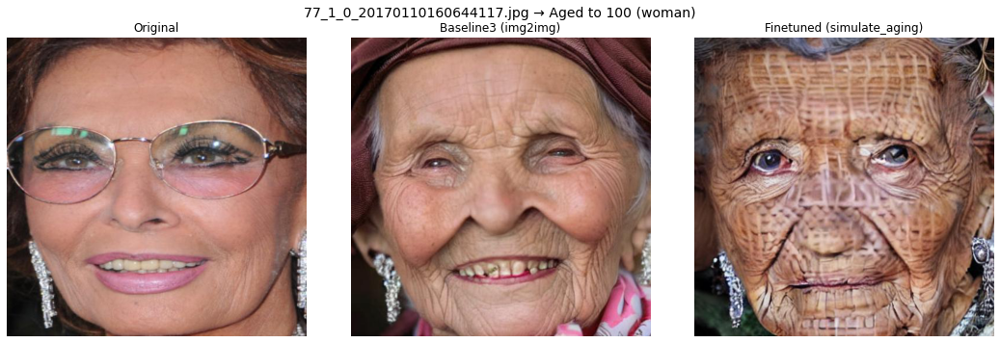

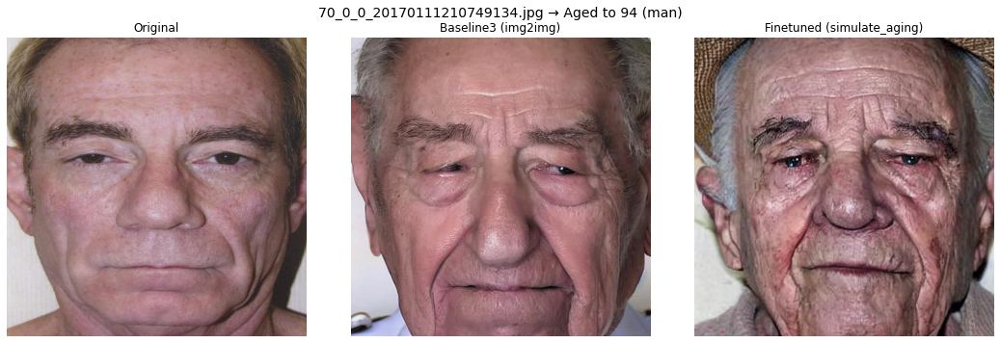

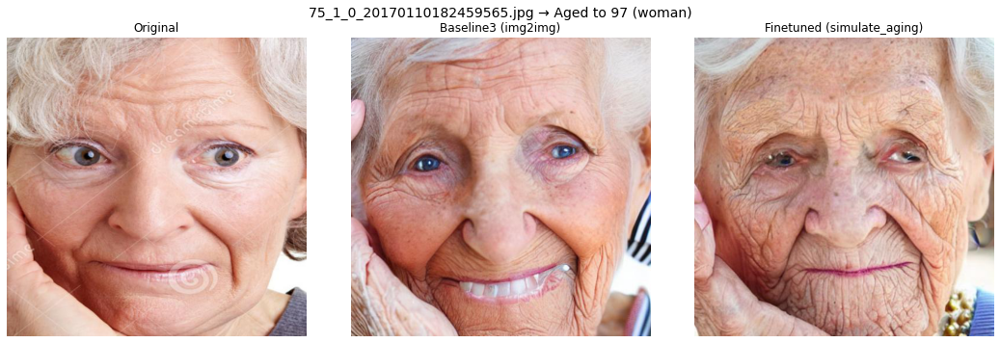

In [15]:
show_batch_images("outputs_part9.csv", max_images=10)